In [1]:
%load_ext autoreload
%autoreload 2
import sys
sys.path.append('../Scripts') 
sys.path.append('../Data')
sys.path.append('../Models')

In [2]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
%load_ext autoreload
%autoreload 2

from imagenet_use import Imagenet1k  
from imagenet_classes import IMAGENET2012_CLASSES  
from class_embedding_from_train import get_class_embeddings_train
from class_embedding_from_val import get_class_embeddings_val

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
%load_ext autoreload
%autoreload 2
dataset_builder = Imagenet1k()
print(dataset_builder._info())  
print(IMAGENET2012_CLASSES["n01440764"])  

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
DatasetInfo(description='ILSVRC 2012, commonly known as \'ImageNet\' is an image dataset organized according to the WordNet hierarchy. Each meaningful concept in WordNet, possibly described by multiple words or word phrases, is called a "synonym set" or "synset". There are more than 100,000 synsets in WordNet, majority of them are nouns (80,000+). ImageNet aims to provide on average 1000 images to illustrate each synset. Images of each concept are quality-controlled and human-annotated. In its completion, ImageNet hopes to offer tens of millions of cleanly sorted images for most of the concepts in the WordNet hierarchy. ImageNet 2012 is the most commonly used subset of ImageNet. This dataset spans 1000 object classes and contains 1,281,167 training images, 50,000 validation images and 100,000 test images.\n', citation='@article{imagenet15russakovsky,\n    Author = {Olga Russakovsky and Jia Deng and 

In [5]:
import torch
import tarfile
import torchvision.transforms as transforms
from torchvision import models
import os
from collections import Counter

In [6]:
#Counting the number of images in val set to see if all is downloaded
def count_images_in_archives():
    class_counts = Counter()
    base_path = '../Data'
    archive_patterns_val = [
        'val_images.tar.gz'  
    ]        
    for pattern in archive_patterns_val:
        file_path = os.path.join(base_path, pattern)          
        with tarfile.open(file_path, 'r:gz') as tar:
            for member in tar.getmembers():
                if member.isfile() and member.name.endswith('.JPEG'):
                    synset_id = member.name.split('_')[-1].split('.')[0]
                    label = IMAGENET2012_CLASSES.get(synset_id)
                    if label:
                        class_counts[label] += 1
    
    return class_counts
        


In [7]:
image_counts = count_images_in_archives()
for label, count in image_counts.items():
    print(f"{label}: {count}")

coucal: 50
Italian greyhound: 50
volcano: 50
Welsh springer spaniel: 50
chickadee: 50
mitten: 50
envelope: 50
sombrero: 50
dung beetle: 50
balance beam, beam: 50
sulphur-crested cockatoo, Kakatoe galerita, Cacatua galerita: 50
shower cap: 50
Petri dish: 50
coffeepot: 50
Angora, Angora rabbit: 50
golfcart, golf cart: 50
yellow lady's slipper, yellow lady-slipper, Cypripedium calceolus, Cypripedium parviflorum: 50
trailer truck, tractor trailer, trucking rig, rig, articulated lorry, semi: 50
chiton, coat-of-mail shell, sea cradle, polyplacophore: 50
sports car, sport car: 50
marimba, xylophone: 50
starfish, sea star: 50
earthstar: 50
African grey, African gray, Psittacus erithacus: 50
burrito: 50
standard poodle: 50
sandbar, sand bar: 50
hip, rose hip, rosehip: 50
fiddler crab: 50
slot, one-armed bandit: 50
window shade: 50
crayfish, crawfish, crawdad, crawdaddy: 50
drum, membranophone, tympan: 50
Model T: 50
conch: 50
digital watch: 50
dalmatian, coach dog, carriage dog: 50
china cabine

In [32]:
#Counting the number of images in train set to see if all is downloaded
def count_images_in_archives():
        class_counts = Counter()
        base_path = '../Data'
        archive_patterns = [
            ('train_images_{}.tar.gz', 5)
        ]        
        for pattern, count in archive_patterns:
            for i in range(count):                
                file_path = os.path.join(base_path, pattern.format(i))
                with tarfile.open(file_path, 'r:gz') as tar:
                    for member in tar.getmembers():
                        if member.isfile() and member.name.endswith('.JPEG'):
                            synset_id = os.path.basename(member.name).split('_')[0]
                            label = IMAGENET2012_CLASSES.get(synset_id)
                            if label:
                                class_counts[label] += 1
        
        return class_counts


In [33]:
%load_ext autoreload
%autoreload 2
image_counts = count_images_in_archives()
for label, count in image_counts.items():
    print(f"{label}: {count}")

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
plane, carpenter's plane, woodworking plane: 1300
comic book: 1300
junco, snowbird: 1300
zucchini, courgette: 1300
stingray: 1300
scuba diver: 1300
miniskirt, mini: 1300
grand piano, grand: 1300
parallel bars, bars: 1300
syringe: 1300
trilobite: 1300
steel drum: 1300
golfcart, golf cart: 1300
Windsor tie: 1213
racket, racquet: 1300
cocker spaniel, English cocker spaniel, cocker: 1300
cairn, cairn terrier: 1300
Airedale, Airedale terrier: 1300
tiger, Panthera tigris: 1300
tape player: 1300
sea anemone, anemone: 1300
baboon: 1300
rocking chair, rocker: 1300
can opener, tin opener: 1300
dam, dike, dyke: 1300
maillot, tank suit: 1300
oil filter: 1120
goose: 1300
white stork, Ciconia ciconia: 1300
tarantula: 1300
window shade: 1300
espresso maker: 1136
bullfrog, Rana catesbeiana: 1300
lumbermill, sawmill: 1300
wine bottle: 1300
valley, vale: 1300
pier: 1300
Pekinese, Pekingese, Peke: 1300
yawl: 1206
chee

In [8]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)
model_path = '../Models/resnet50_imagenet_v2.pth'
model = models.resnet50()
model.load_state_dict(torch.load(model_path))
model.to(device)
model.eval()


cuda


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [47]:
# Code sanity check to check the number of images in the train_images_0.tar.gz

'''class_embeddings_test = defaultdict(list)

base_path = '../Data'
archive_patterns = [('train_images_0.tar.gz', 1)]   
for pattern, count in archive_patterns:
        for i in range(count):
            file_path = os.path.join(base_path, pattern.format(i))          
            with tarfile.open(file_path, 'r:gz') as tar:
                for member in tar.getmembers():
                    if member.isfile() and member.name.endswith('.JPEG'):
                        synset_id = os.path.basename(member.name).split('_')[0]
                        label = IMAGENET2012_CLASSES.get(synset_id)
                        class_embeddings_test[label] = synset_id
                        count+=1
print(count)    #Total Images + 1 count starts from 1
print(class_embeddings_test)'''

256235
defaultdict(<class 'list'>, {"plane, carpenter's plane, woodworking plane": 'n03954731', 'comic book': 'n06596364', 'junco, snowbird': 'n01534433', 'zucchini, courgette': 'n07716358', 'stingray': 'n01498041', 'scuba diver': 'n10565667', 'miniskirt, mini': 'n03770439', 'grand piano, grand': 'n03452741', 'parallel bars, bars': 'n03888605', 'syringe': 'n04376876', 'trilobite': 'n01768244', 'steel drum': 'n04311174', 'golfcart, golf cart': 'n03445924', 'Windsor tie': 'n04591157', 'racket, racquet': 'n04039381', 'cocker spaniel, English cocker spaniel, cocker': 'n02102318', 'cairn, cairn terrier': 'n02096177', 'Airedale, Airedale terrier': 'n02096051', 'tiger, Panthera tigris': 'n02129604', 'tape player': 'n04392985', 'sea anemone, anemone': 'n01914609', 'baboon': 'n02486410', 'rocking chair, rocker': 'n04099969', 'can opener, tin opener': 'n02951585', 'dam, dike, dyke': 'n03160309', 'maillot, tank suit': 'n03710721', 'oil filter': 'n03843555', 'goose': 'n01855672', 'white stork, Cic

In [9]:
class_average_embeddings_val = get_class_embeddings_val()

cuda


In [10]:
print(class_average_embeddings_val)

{'coucal': array([ 1.02743328e-01,  2.40884107e-02, -7.74020478e-02,  1.29360175e-02,
       -4.60451357e-02, -1.64616570e-01,  3.56528442e-03,  3.06680620e-01,
        2.71868944e-01,  1.95037514e-01, -3.78852338e-02, -2.40462348e-01,
        3.78947496e-01,  4.02588136e-02,  4.98957059e-04,  5.06415069e-01,
        5.72270870e-01,  2.97305286e-01,  4.89243656e-01,  1.28304169e-01,
       -2.34142952e-02,  1.17852342e+00,  1.36806756e-01,  2.67429531e-01,
       -9.53807831e-02, -2.13781431e-01, -1.85645461e-01,  1.50546283e-01,
       -2.25256179e-02,  1.15313366e-01, -3.12755615e-01, -1.53164804e-01,
       -2.84796804e-01, -2.10686192e-01, -1.07895173e-01, -1.60408571e-01,
       -9.80549976e-02,  3.84633429e-02, -4.06558141e-02,  1.03456557e-01,
       -1.01520754e-01, -1.83621466e-01,  2.01558068e-01,  1.47517025e-01,
       -2.45903954e-01,  5.17847836e-02,  1.75771728e-01, -1.13479726e-01,
       -9.94110480e-02, -1.80662513e-01, -6.59693703e-02, -9.80644450e-02,
        4.6045

In [11]:
embeddings_tensor = torch.stack([torch.tensor(class_average_embeddings_val[key]) for key in class_average_embeddings_val])
embeddings_tensor_norm = torch.nn.functional.normalize(embeddings_tensor, p=2, dim=1)
cosine_similarity_matrix = torch.mm(embeddings_tensor_norm, embeddings_tensor_norm.transpose(0, 1))
cosine_dissimilarity_matrix = 1 - cosine_similarity_matrix
cosine_similarity_matrix_np = cosine_similarity_matrix.numpy()


In [12]:
import pandas as pd
cosine_dissimilarity_matrix_np = cosine_dissimilarity_matrix.numpy()
pd.DataFrame(cosine_dissimilarity_matrix_np).to_csv('../Data/cosine_dissimilarity_matrix.csv', index=False, header=False)

In [13]:
cosine_dissimilarity_matrix_np = cosine_dissimilarity_matrix.numpy()
pd.DataFrame(cosine_dissimilarity_matrix_np).to_pickle('../Data/cosine_dissimilarity_matrix.pkl')

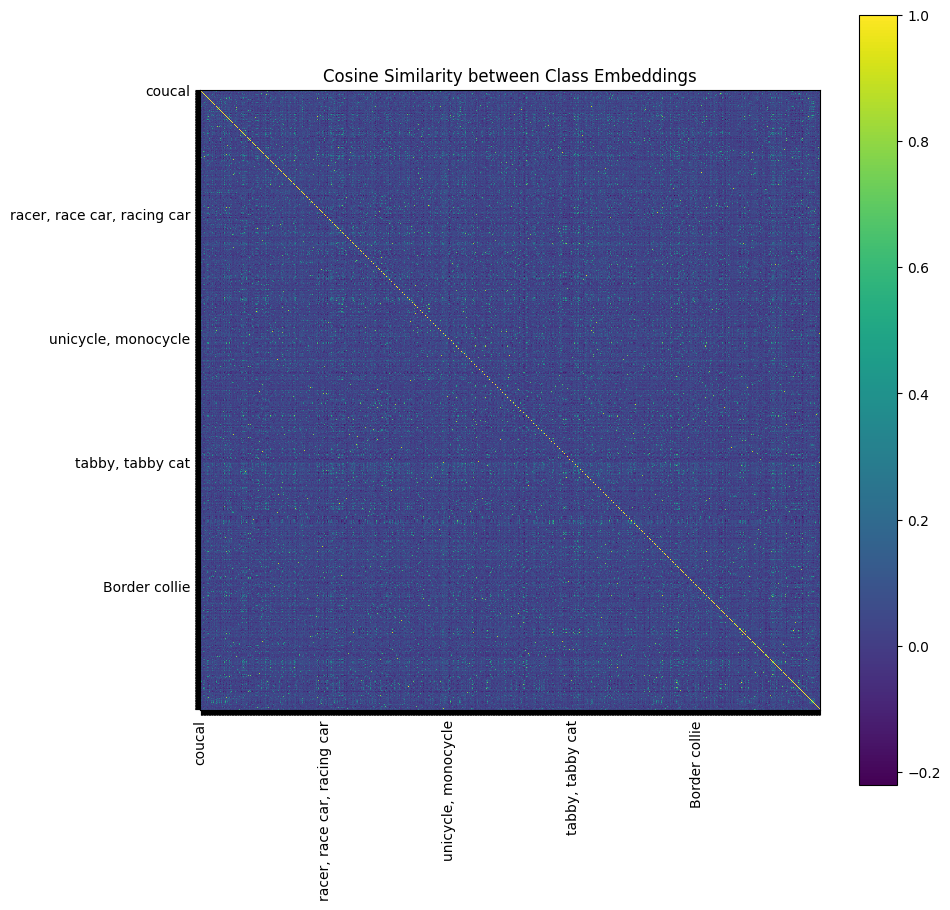

In [15]:
import numpy as np
import matplotlib.pyplot as plt
cosine_similarity_matrix_np = cosine_similarity_matrix.numpy()
plt.figure(figsize=(10,10))
plt.imshow(cosine_similarity_matrix_np, interpolation='nearest', cmap='viridis')
plt.title('Cosine Similarity between Class Embeddings')
plt.colorbar()
class_labels = list(class_average_embeddings_val.keys())
plt.xticks(np.arange(len(class_labels)), class_labels, rotation=90)
plt.yticks(np.arange(len(class_labels)), class_labels)
every_nth = 200
for n, label in enumerate(plt.gca().xaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)
for n, label in enumerate(plt.gca().yaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)

plt.show()


In [48]:
'''def get_class_embeddings():
    class_embeddings = defaultdict(list)
    base_path = '../Data'
    archive_patterns = [('train_images_{}.tar.gz', 5)]    
    preprocess = transforms.Compose([
        transforms.Resize(224),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])    
    for pattern, count in archive_patterns:
        for i in range(count):
            file_path = os.path.join(base_path, pattern.format(i))          
            with tarfile.open(file_path, 'r:gz') as tar:
                for member in tar.getmembers():
                    if member.isfile() and member.name.endswith('.JPEG'):
                        synset_id = os.path.basename(member.name).split('_')[0]
                        label = IMAGENET2012_CLASSES.get(synset_id)
                        if label:                           
                            file = tar.extractfile(member)
                            img = Image.open(BytesIO(file.read()))
                            img = img.convert('RGB')
                            img_tensor = preprocess(img).unsqueeze(0).to(device)
                            with torch.no_grad():  
                                embedding = model(img_tensor)
                                embedding = embedding.cpu()
                            class_embeddings[label].append(embedding.squeeze().numpy())
    averaged_class_embeddings = {label: sum(embeds)/len(embeds) for label, embeds in class_embeddings.items()}
    return averaged_class_embeddings
class_average_embeddings = get_class_embeddings()
'''

class_average_embeddings_train = get_class_embeddings_train()

In [49]:
embeddings_tensor = torch.stack([torch.tensor(class_average_embeddings_train[key]) for key in class_average_embeddings_train])
embeddings_tensor_norm = torch.nn.functional.normalize(embeddings_tensor, p=2, dim=1)
cosine_similarity_matrix = torch.mm(embeddings_tensor_norm, embeddings_tensor_norm.transpose(0, 1))
cosine_similarity_matrix_np = cosine_similarity_matrix.numpy()


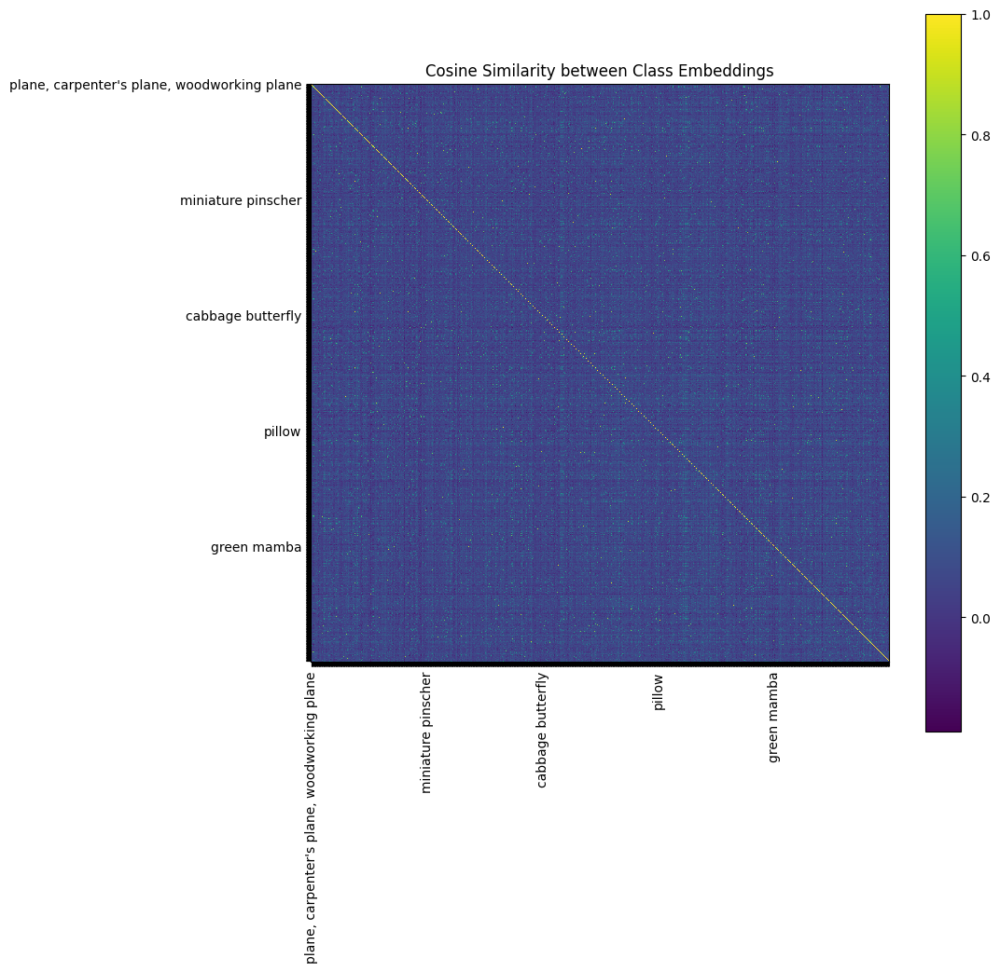

In [51]:
cosine_similarity_matrix_np = cosine_similarity_matrix.numpy()

plt.figure(figsize=(10,10))
plt.imshow(cosine_similarity_matrix_np, interpolation='nearest', cmap='viridis')
plt.title('Cosine Similarity between Class Embeddings')
plt.colorbar()
class_labels = list(class_average_embeddings_train.keys())
plt.xticks(np.arange(len(class_labels)), class_labels, rotation=90)
plt.yticks(np.arange(len(class_labels)), class_labels)

every_nth = 200
for n, label in enumerate(plt.gca().xaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)
for n, label in enumerate(plt.gca().yaxis.get_ticklabels()):
    if n % every_nth != 0:
        label.set_visible(False)

plt.show()
